# Optimize parameters for the reference case for SPYDELL method

In [1]:
import xarray as xr
import pandas as pd
import numpy as np

import hvplot.xarray
import hvplot.pandas

import matplotlib.pyplot as plt
from cycler import cycler

from sstats import signals as sg
from sstats import sigp as sigp
from sstats import tseries as ts
from sstats import get_cmap_colors

import hvplot.xarray
import hvplot.pandas
import holoviews as hv

import pynsitu as pyn
import lib as lib
from lib import KEYS, raw_dir, images_dir
import os
from glob import glob


import synthetic_traj as st

from synthetic_traj import synthetic_traj, noise_irregular_sampling, ref_case, typical_case

/Users/mdemol/opt/anaconda3/envs/mdenv/lib/python3.9/site-packages/pyTMD/tools.py:55: UserWarning: ipyleaflet not available
  warnings.warn("ipyleaflet not available")
/Users/mdemol/opt/anaconda3/envs/mdenv/lib/python3.9/site-packages/pyTMD/tools.py:56: UserWarning: Some functions will throw an exception if called
  warnings.warn("Some functions will throw an exception if called")


___________
# Reference case

In [2]:
N=20
acc_cut = 1
position_noise=20
ntype = 'white_noise'
offset_type = 'svp_scripps_10'
dt_smooth = '30min'
spectral_diff = False
ref_case['spectral_diff'] = spectral_diff
print(ref_case)

{'T': 5, 'U_low': 0.3, 'U_ni': 0.2, 'U_2': 0, 'U_1': 0, 'tau_eta': 0.1, 'n_layers': 5, 'spectral_diff': False}


In [3]:
DF = dict()

# TRUE
t = (50, '1min') # use it instead of (50, 1/24/60 because otherwise not regularly sampled
dst = synthetic_traj(t, N , **ref_case)# u,v, ax, ay computed
dft = st.dataset2dataframe(dst).rename(columns={'draw':'id'})
DF['True_1min'] = dft

#OBSERVED

dso = noise_irregular_sampling(dst, t, position_noise, ntype=ntype, offset_type=offset_type, istart = 9000)
dfo = st.dataset2dataframe(dso).rename(columns={'draw':'id'})
dfo = dfo.groupby('id').apply(pyn.geo.compute_dt, time='index')

DF['Observed'] = dfo

# Interpolated True
dsti = dst.interp(time = pd.date_range(dfo.index.min(), dfo.index.max(), freq=dt_smooth))
dsti['dt']=dsti.time.diff('time')/pd.Timedelta('1s')
dfti = st.dataset2dataframe(dsti).rename(columns={'draw':'id'})
dfti = dfti.groupby('id').apply(pyn.geo.compute_velocities,time='index', distance='xy', names=('u', 'v', 'U'), fill_startend=True, centered=True, keep_dt=True)
dfti = dfti.groupby('id').apply(pyn.geo.compute_accelerations,from_ =('xy', 'x', 'y'), names=('ax', 'ay', 'Axy'), keep_dt=True)

DF['True_'+dt_smooth] = dfti

centred diff
centred diff
44624.67512128158
9000


___________
# SPYDELL
Parameters : 
- acc_cut
- nb_pt_mean


In [5]:
acc_cut= 1
nb_pt_mean = 5

In [6]:
DF.keys()

dict_keys(['True_1min', 'Observed', 'True_30min'])

___________
# Acc_cut


In [52]:
acc_cut_l = [ 1e-5,2e-5, 3e-5, 4e-5, 5e-5,6e-5, 7e-5,8e-5,9e-5,1e-4]
DF0 = DF.copy()
#SMOOTHED
for accc in acc_cut_l : 
    dfv = pyn.drifters.smooth_all(dfo, 'spydell', dt_smooth, parameters = dict(acc_cut=accc, nb_pt_mean =nb_pt_mean),
                                  spectral_diff = True,
                                  geo = False)
    DF0[f'acc_cut ={accc}']=dfv.astype(float)
DF0.keys()

nb of spike removed 711 over 2400
nb of spike removed 698 over 2400
nb of spike removed 720 over 2400
nb of spike removed 716 over 2400
nb of spike removed 701 over 2400
nb of spike removed 685 over 2400
nb of spike removed 696 over 2400
nb of spike removed 705 over 2400
nb of spike removed 691 over 2400
nb of spike removed 697 over 2400
nb of spike removed 687 over 2400
nb of spike removed 699 over 2400
nb of spike removed 685 over 2400
nb of spike removed 721 over 2400
nb of spike removed 702 over 2400
nb of spike removed 689 over 2400
nb of spike removed 711 over 2400
nb of spike removed 707 over 2400
nb of spike removed 709 over 2400
nb of spike removed 712 over 2400
nb of spike removed 348 over 2400
nb of spike removed 313 over 2400
nb of spike removed 346 over 2400
nb of spike removed 329 over 2400
nb of spike removed 319 over 2400
nb of spike removed 335 over 2400
nb of spike removed 312 over 2400
nb of spike removed 344 over 2400
nb of spike removed 335 over 2400
nb of spike re

dict_keys(['True_1min', 'Observed', 'True_30min', 'acc_cut =1e-05', 'acc_cut =2e-05', 'acc_cut =3e-05', 'acc_cut =4e-05', 'acc_cut =5e-05', 'acc_cut =6e-05', 'acc_cut =7e-05', 'acc_cut =8e-05', 'acc_cut =9e-05', 'acc_cut =0.0001'])

In [62]:
DS = []
#DF0.pop('True_1min')
#DF0.pop('Observed')
lab = []
for l in DF0 :
    if '=' in l:
        dfv = DF0[l].reset_index().set_index(['time', 'id'])
        DS.append(dfv.to_xarray()[['x', 'y','X', 'u', 'v','U', 'ax', 'ay', 'Axy']])
        lab.append(float(l.split('=')[-1]))
ds = xr.concat(DS, dim= lab).rename({'concat_dim':'acc_cut'})

In [59]:
dsvar = (((ds-dsti).var('time'))/(dsti.var('time'))).mean('id')*100
dsvar

<xarray.Dataset>
Dimensions:  (acc_cut: 10)
Coordinates:
  * acc_cut  (acc_cut) float64 1e-05 2e-05 3e-05 4e-05 ... 8e-05 9e-05 0.0001
Data variables:
    x        (acc_cut) float64 0.00223 0.001907 0.001813 ... 0.001789 0.001789
    y        (acc_cut) float64 0.004404 0.003872 0.003693 ... 0.003686 0.003686
    X        (acc_cut) float64 0.003175 0.002631 0.002459 ... 0.002426 0.002426
    u        (acc_cut) float64 0.2013 0.2013 0.2013 ... 0.2013 0.2013 0.2013
    v        (acc_cut) float64 0.2016 0.2016 0.2016 ... 0.2016 0.2016 0.2016
    U        (acc_cut) float64 0.4443 0.4443 0.4443 ... 0.4443 0.4443 0.4443
    ax       (acc_cut) float64 121.2 114.8 111.8 110.8 ... 110.1 110.4 110.4
    ay       (acc_cut) float64 113.7 106.8 103.5 102.8 ... 102.3 102.3 102.3
    Axy      (acc_cut) float64 237.6 230.2 227.0 225.5 ... 224.3 225.2 225.2

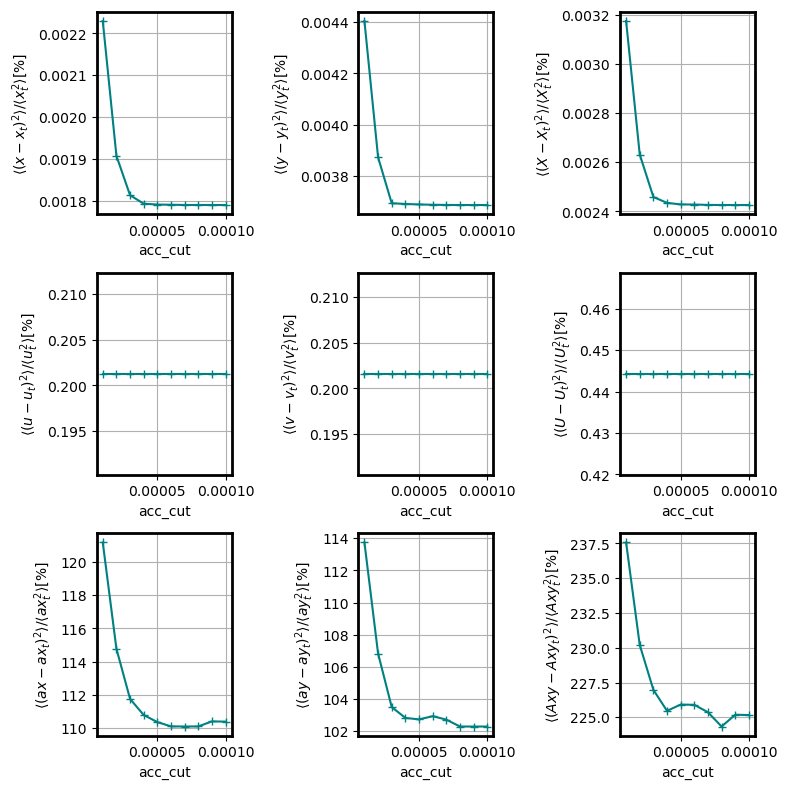

In [84]:
fig, axs = plt.subplots(3,3, figsize=(8,8))
axs = axs.flatten()
i=0
for v in ['x','y','X','u','v','U','ax','ay', 'Axy']:
    dsvar[v].plot(ax=axs[i], marker = '+', c='teal')
    #dsvar[v].min().plot(ax=axs[i], marker = 'o', color='r')
    axs[i].set_ylabel(fr'$\langle ({v}-{v}_t)^2 \rangle / \langle {v}_t^2 \rangle [\%]$')
    i+=1
    
for a in axs :
    a.grid()
fig.tight_layout()

___________
# nb_pt_mean

In [4]:
nb_pt_mean_l = np.arange(3,10, 2)
DF1 = DF.copy()
#SMOOTHED
for nb in nb_pt_mean_l : 
    dfv = pyn.drifters.smooth_all(dfo, 'spydell', dt_smooth, parameters = dict(acc_cut=acc_cut,nb_pt_mean = nb), geo = False)
    DF1[f'nb_pt_mean ={nb}']=dfv
DF1.keys()

nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of spike removed 0 over 2400
nb of sp

dict_keys(['True_1min', 'Observed', 'True_30min', 'nb_pt_mean =3', 'nb_pt_mean =5', 'nb_pt_mean =7', 'nb_pt_mean =9'])

In [8]:
d=0
st.hvplot_DF(DF1, d, ['x', 'y', 'u','v','ax', 'ay'])

6


:Layout
   .Overlay.I   :Overlay
      .Curve.True_1min.I         :Curve   [time]   (x)
      .Curve.True_1min.II        :Curve   [time]   (x)
      .Curve.Observed            :Curve   [time]   (x)
      .Curve.True_30min          :Curve   [time]   (x)
      .Curve.Nb_pt_mean_equals_3 :Curve   [time]   (x)
      .Curve.Nb_pt_mean_equals_5 :Curve   [time]   (x)
      .Curve.Nb_pt_mean_equals_7 :Curve   [time]   (x)
      .Curve.Nb_pt_mean_equals_9 :Curve   [time]   (x)
   .Overlay.II  :Overlay
      .Curve.True_1min.I         :Curve   [time]   (y)
      .Curve.True_1min.II        :Curve   [time]   (y)
      .Curve.Observed            :Curve   [time]   (y)
      .Curve.True_30min          :Curve   [time]   (y)
      .Curve.Nb_pt_mean_equals_3 :Curve   [time]   (y)
      .Curve.Nb_pt_mean_equals_5 :Curve   [time]   (y)
      .Curve.Nb_pt_mean_equals_7 :Curve   [time]   (y)
      .Curve.Nb_pt_mean_equals_9 :Curve   [time]   (y)
   .Overlay.III :Overlay
      .Curve.True_1min.I         :Curve   [time]   (u)
      .Curve.True_1min.II        :Curve   [time]   (u)
      .Curve.Observed            :Curve   [time]   (u)
      .Curve.True_30min          :Curve   [time]   (u)
      .Curve.Nb_pt_mean_equals_3 :Curve   [time]   (u)
      .Curve.Nb_pt_mean_equals_5 :Curve   [time]   (u)
      .Curve.Nb_pt_mean_equals_7 :Curve   [time]   (u)
      .Curve.Nb_pt_mean_equals_9 :Curve   [time]   (u)
   .Overlay.IV  :Overlay
      .Curve.True_1min.I         :Curve   [time]   (v)
      .Curve.True_1min.II        :Curve   [time]   (v)
      .Curve.Observed            :Curve   [time]   (v)
      .Curve.True_30min          :Curve   [time]   (v)
      .Curve.Nb_pt_mean_equals_3 :Curve   [time]   (v)
      .Curve.Nb_pt_mean_equals_5 :Curve   [time]   (v)
      .Curve.Nb_pt_mean_equals_7 :Curve   [time]   (v)
      .Curve.Nb_pt_mean_equals_9 :Curve   [time]   (v)
   .Overlay.V   :Overlay
      .Curve.True_1min.I         :Curve   [time]   (ax)
      .Curve.True_1min.II        :Curve   [time]   (ax)
      .Curve.Observed            :Curve   [time]   (ax)
      .Curve.True_30min          :Curve   [time]   (ax)
      .Curve.Nb_pt_mean_equals_3 :Curve   [time]   (ax)
      .Curve.Nb_pt_mean_equals_5 :Curve   [time]   (ax)
      .Curve.Nb_pt_mean_equals_7 :Curve   [time]   (ax)
      .Curve.Nb_pt_mean_equals_9 :Curve   [time]   (ax)
   .Overlay.VI  :Overlay
      .Curve.True_1min.I         :Curve   [time]   (ay)
      .Curve.True_1min.II        :Curve   [time]   (ay)
      .Curve.Observed            :Curve   [time]   (ay)
      .Curve.True_30min          :Curve   [time]   (ay)
      .Curve.Nb_pt_mean_equals_3 :Curve   [time]   (ay)
      .Curve.Nb_pt_mean_equals_5 :Curve   [time]   (ay)
      .Curve.Nb_pt_mean_equals_7 :Curve   [time]   (ay)
      .Curve.Nb_pt_mean_equals_9 :Curve   [time]   (ay)

___________
# REMS

In [52]:
dfms = st.ms_diff(DF1, true_key='True_'+dt_smooth).iloc[1:,:].astype(float)

True_1min has not the same time index
Observed has not the same time index


In [53]:
dfms

,x,y,u,v,ax,ay,X,U,Axy,ratio_x,ratio_y,ratio_u,ratio_v,ratio_ax,ratio_ay,ratio_X,ratio_U,ratio_Axy
nb_pt_mean =3,734015.957789,813586.929851,0.000195,0.000194,3.878937e-10,3.469708e-10,742075.059415,0.000196,5.729211e-10,0.000009,0.000022,0.001525,0.001555,1.508638,1.314739,0.000006,0.000768,1.099637
nb_pt_mean =5,735921.964565,815502.802837,0.000165,0.000165,3.540109e-10,2.862876e-10,744195.262197,0.000166,5.321677e-10,0.000009,0.000022,0.001283,0.001320,1.379095,1.086639,0.000006,0.000649,1.023474
nb_pt_mean =7,743554.248457,823848.466734,0.000237,0.000239,3.269731e-10,2.722377e-10,753017.768260,0.000245,5.052784e-10,0.000009,0.000022,0.001844,0.001915,1.273195,1.032051,0.000006,0.000955,0.970618
nb_pt_mean =9,761195.864145,843539.878616,0.000424,0.000427,3.287110e-10,2.722588e-10,773538.102021,0.000445,5.113561e-10,0.000010,0.000022,0.003298,0.003415,1.279203,1.033589,0.000006,0.001738,0.982740


In [54]:
dfms['Number of points in boxcar mean']=[int(v.split('=')[-1]) for v in dfms.index]
dfms = dfms.set_index('Number of points in boxcar mean')
dfms=dfms.iloc[:-1]

In [55]:
dfms

,x,y,u,v,ax,ay,X,U,Axy,ratio_x,ratio_y,ratio_u,ratio_v,ratio_ax,ratio_ay,ratio_X,ratio_U,ratio_Axy
Number of points in boxcar mean,,,,,,,,,,,,,,,,,,
3,734015.957789,813586.929851,0.000195,0.000194,3.878937e-10,3.469708e-10,742075.059415,0.000196,5.729211e-10,0.000009,0.000022,0.001525,0.001555,1.508638,1.314739,0.000006,0.000768,1.099637
5,735921.964565,815502.802837,0.000165,0.000165,3.540109e-10,2.862876e-10,744195.262197,0.000166,5.321677e-10,0.000009,0.000022,0.001283,0.001320,1.379095,1.086639,0.000006,0.000649,1.023474
7,743554.248457,823848.466734,0.000237,0.000239,3.269731e-10,2.722377e-10,753017.768260,0.000245,5.052784e-10,0.000009,0.000022,0.001844,0.001915,1.273195,1.032051,0.000006,0.000955,0.970618


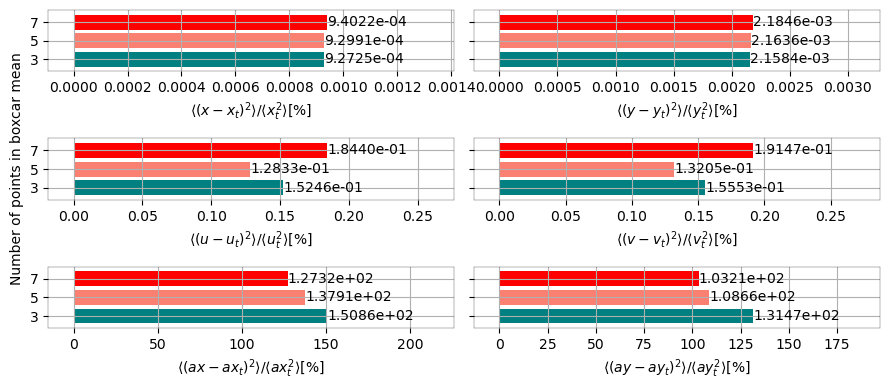

In [56]:

fig, axs = plt.subplots(3,2, sharey=True, figsize = (9,4))
i=0
axs = axs.flatten()
for var in ['x', 'y', 'u','v', 'ax','ay'] : 
    ax=axs[i]
    (dfms['ratio_' + var]*100).plot.barh(ax=ax, color =['teal', 'salmon', 'red'], width =0.8)
    ax.grid()
    ax.set_xlim(-0.1*dfms['ratio_' + var].max()*100, dfms['ratio_' + var].max()*1.5*100)
    i+=1
    ax.set_xlabel(fr'$\langle ({var}-{var}_t)^2 \rangle / \langle {var}_t^2 \rangle [\%]$')
    ax.bar_label(ax.containers[0], labels =[ np.format_float_scientific(l,precision = 4, exp_digits=2) for l in dfms['ratio_' +var].values*100])
    
axs[0].set_ylabel('')
axs[4].set_ylabel('')

fig.tight_layout()
fig.savefig(os.path.join(images_dir, 'SPYDELL_opt_norm.png'), dpi =200, bbox_inches="tight")

___________
# SPECTRA

In [15]:
DF0 = DF1.copy()
#DF0.pop('True_1min')
DF0.pop('nb_pt_mean =9')
DSE = st.spectrum_DF(DF0,nperseg='20D', detrend = 'linear')
#dse = st.DSE2dse(DSE)
#dsen = sum(st.negpos_spectra(dse))

True_1min
True_30min
nb_pt_mean =3
nb_pt_mean =5
nb_pt_mean =7


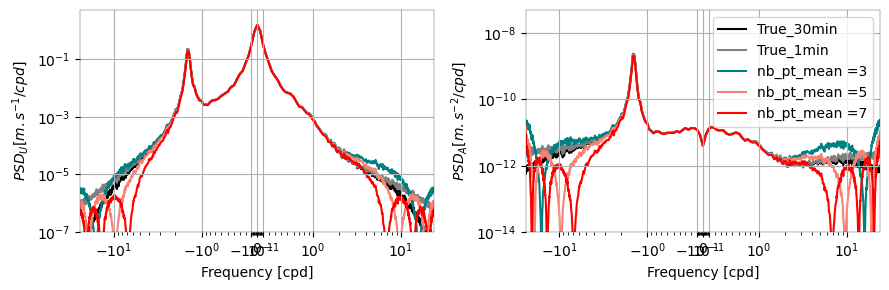

In [16]:
linthresh =5e-1
linscale = 0.3
color = {'True_30min':'k','True_1min':'grey', 'nb_pt_mean =3' : 'teal', 'nb_pt_mean =5':'salmon', 'nb_pt_mean =7':'red'}
zorder = {'True_30min':0,'True_1min':0, 'nb_pt_mean =3' : 1, 'nb_pt_mean =5':1, 'nb_pt_mean =7':1}

fig, axs = plt.subplots(1, 2, figsize=(9,3))
ax=axs[0]
for l in color.keys():
    DSE[l].u_v.mean('id').plot( ax=ax, label=l, color=color[l], zorder=zorder[l],)
ax.grid()
ax.set_xscale('symlog',linthresh =linthresh, linscale =linscale)
ax.set_yscale('log')
ax.set_xlim(-24*60/30/2,24*60/30/2)
ax.set_ylim(1e-7, 5e0)
ax.set_ylabel(r'$PSD_{U} [m.s^{-1}/cpd]$')
ax.set_xlabel('Frequency [cpd]')
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))

ax=axs[1]
for l in color.keys():
    DSE[l].ax_ay.mean('id').plot( ax=ax, label=l, color=color[l], zorder=zorder[l],)
ax.grid()
ax.set_xscale('symlog',linthresh =linthresh, linscale =linscale)
ax.set_yscale('log')
ax.set_xlim(-24*60/30/2,24*60/30/2)
ax.set_ylim(1e-14,5e-8)
ax.set_ylabel(r'$PSD_{A} [m.s^{-2}/cpd]$')
ax.set_xlabel('Frequency [cpd]')
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))
ax.legend()
fig.tight_layout()
fig.savefig(os.path.join(images_dir, 'SPYDELL_opt_spectra.png'), dpi =200, bbox_inches="tight")

In [19]:
DF_diff = st.build_DF_diff(DF0, true_key='True_30min')
DSE_d = st.spectrum_DF(DF_diff)

True_1min has not the same time index
Observed has not the same time index
nb_pt_mean =3
nb_pt_mean =5
nb_pt_mean =7


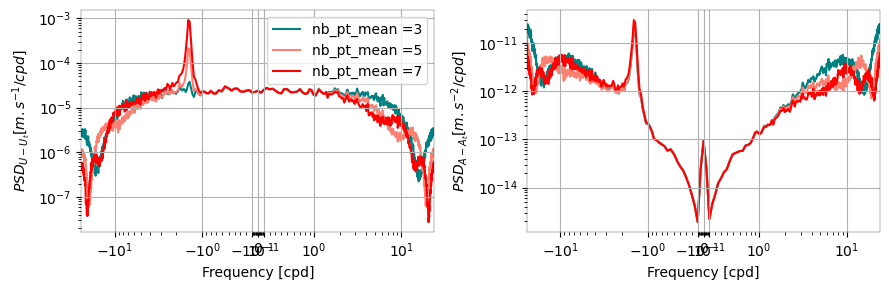

In [20]:
fig, axs = plt.subplots(1, 2, figsize=(9,3))
ax=axs[0]
#DSE_d.pop('nb_pt_mean =9')
for l in DSE_d.keys():
    DSE_d[l].u_v.mean('id').plot( ax=ax,color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale('symlog',linthresh =linthresh, linscale =linscale)
ax.set_yscale('log')
ax.set_xlim(-24*60/30/2,24*60/30/2)
#ax.set_ylim(1e-7, 5e0)
ax.set_ylabel(r'$PSD_{U-U_t} [m.s^{-1}/cpd]$')
ax.set_xlabel('Frequency [cpd]')
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))
ax.legend()

ax=axs[1]
for l in DSE_d.keys():
    DSE_d[l].ax_ay.mean('id').plot( ax=ax,color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale('symlog',linthresh =linthresh, linscale =linscale)
ax.set_yscale('log')
ax.set_xlim(-24*60/30/2,24*60/30/2)
#ax.set_ylim(5e-13, 1e-5)
ax.set_ylabel(r'$PSD_{A-A_t} [m.s^{-2}/cpd]$')
ax.set_xlabel('Frequency [cpd]')
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))
fig.tight_layout()
fig.savefig(os.path.join(images_dir, 'SPYDELL_opt_diffspectra.png'), dpi =200, bbox_inches="tight")

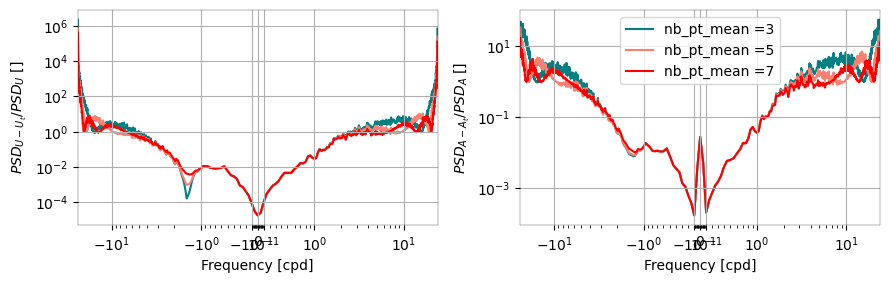

In [21]:
fig, axs = plt.subplots(1, 2, figsize=(9,3))
ax=axs[0]
for l in DSE_d.keys():
    (DSE_d[l].u_v/DSE['True_30min'].u_v).mean('id').plot( ax=ax,color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale('symlog',linthresh =linthresh, linscale =linscale)
ax.set_yscale('log')
ax.set_xlim(-24*60/30/2,24*60/30/2)
#ax.set_ylim(1e-7, 5e0)
ax.set_ylabel(r'$PSD_{U-U_t}/PSD_{U}$ []')
ax.set_xlabel('Frequency [cpd]')
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))

ax=axs[1]
for l in DSE_d.keys():
    (DSE_d[l].ax_ay/DSE['True_30min'].ax_ay).mean('id').plot( ax=ax,color=color[l], zorder=zorder[l], label=l)
ax.grid()
ax.set_xscale('symlog',linthresh =linthresh, linscale =linscale)
ax.set_yscale('log')
ax.set_xlim(-24*60/30/2,24*60/30/2)
#ax.set_ylim(5e-13, 1e-5)
ax.set_ylabel(r'$PSD_{A-A_t}/PSD_{A}$ []')
ax.set_xlabel('Frequency [cpd]')
ax.xaxis.set_minor_locator(lib.MinorSymLogLocator(1e-1))
ax.legend()
fig.tight_layout()
fig.savefig(os.path.join(images_dir, 'SPYDELL_opt_diffspectra_normed.png'), dpi =200, bbox_inches="tight")